Code idea:
1) define lattice of TLS

2) calculate Green tensor between TLS -> G_ij
3) Diagonalize Green tensor and define collective TLS operator by projecting on its eigenstates

4) define drive as an external input electric field (Gaussian beam for instance)
5) define H and master eq. with drive
6) look at steady state -> avg sigma gives the flourescence spectrum (speckle patterns), compute correlations. Convolute with Green tensor to calculate real space patters
7) make a nice sperical coordinate plot for fixed distance. Make a x-z section plot of the field intensity (see typical dipole shape)


In [61]:
import numpy as np
import scipy
from qutip import *
from numba import jit, njit

import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import LinearSegmentedColormap

from mpl_toolkits.mplot3d import Axes3D
from plotly.offline import plot
import plotly.graph_objs as go

In [62]:
@njit
def adim_free_dyadic(vec_r1, vec_r2, k0):
    a0 = 60. + 1j*0. #space cutoff in nm
    r = k0*( vec_r1 - vec_r2 ) + 1j*0.
    r0 = np.sqrt(np.abs(np.dot(r,r)) ) + 1j*0.
    
    G = np.zeros( shape=(3,3), dtype=np.complex_ )

    r_k_r = ( np.outer(r,r) ) + 1j*0.
    if np.abs(r0) > .00001:

        G = np.exp( 1j*r0 )/(4*np.pi) * ( (1./r0 + 1./r0**2. - 1./r0**3.)*np.eye(3) + (3./r0**3. - 3.*1j/r0**2. - 1./r0)*r_k_r/r0**2.  ) * ( 1. - np.exp(-(np.abs(r0/k0/a0))**4.) )
    
    return G
@njit
def adim_half_space_dyadic(vec_r1, vec_r2, k0_ref, z0, img_active):
    img_A = 0
    if img_active == 1:
        img_A = 1
    
    reflectance = 1.
    
    k0 = k0_ref + 1j*k0_ref*.0
        
    r = k0*( vec_r1 - vec_r2 ) + 1j*0.
    r0 = np.sqrt(np.abs(np.dot(r,r)) ) + 1j*0.
    
    Mrinv = np.diag( np.array([1.+1j*0., 1.+1j*0., -1.+1j*0.]) )
    MZ = np.diag( np.array([0.+1j*0., 0.+1j*0., 1.+1j*0.]) )
    
    plane_pos = np.array([0.+1j*0., 0.+1j*0., z0+1j*0.])
    rI = k0*(vec_r1 - ( Mrinv @ (vec_r2+1j*0.) + 2.*plane_pos ) ) + 1j*0.
    rI0 = np.sqrt(np.abs(np.dot(rI,rI)) ) + 1j*0.
    
    r_k_r = ( np.outer(r,r) ) + 1j*0.
    rI_k_rI = ( np.outer(rI,rI) ) + 1j*0.
    
    G = np.zeros( shape=(3,3), dtype=np.complex_ )
    G0 = np.zeros( shape=(3,3), dtype=np.complex_ )
    GI = np.zeros( shape=(3,3), dtype=np.complex_ )
    if np.abs(r0) > .0001:
        Mn0 = - np.exp( 1j*r0 )/(4*np.pi) * ( np.eye(3)/r0**3. - 3.*r_k_r/r0**5. ) #* ( 1. - np.exp(-(np.abs(r0/k0/a0))**4.) )
        Mf0 = np.exp( 1j*r0 )/(4*np.pi)*( np.eye(3)*( 1./r0 + 1j/r0**2.) - r_k_r/r0**2.*( 1./r0 + 3*1j/r0**2.) )
        G0 = Mf0 + Mn0
    
    if np.abs(rI0) > .000001:   
        MnI = - np.exp( 1j*rI0 )/(4*np.pi) * ( np.eye(3)/rI0**3. - 3.*rI_k_rI/rI0**5. )
        MfI = np.exp( 1j*rI0 )/(4*np.pi)*( np.eye(3)*( 1./rI0 + 1j/rI0**2.) - rI_k_rI/rI0**2.*( 1./rI0 + 3*1j/rI0**2.) )
        GI = MfI + MnI #- 2.*MZ*np.exp( 1j*rI0 )/(4*np.pi)*( 1./rI0)
    G = G0 - img_A*reflectance * (GI @ Mrinv )
    
    return G

@njit
def system_dyadic_field_amplitude( R, D, k0, N_TLS, xvec, yvec, zvec, z0, img_active ):    
    arr_Ex = np.zeros(shape=(xvec.size*yvec.size*zvec.size, N_TLS), dtype=np.complex_)
    arr_Ey = np.zeros(shape=(xvec.size*yvec.size*zvec.size, N_TLS), dtype=np.complex_)
    arr_Ez = np.zeros(shape=(xvec.size*yvec.size*zvec.size, N_TLS), dtype=np.complex_)
    
    count = 0
    for nx in range(xvec.size):
        for ny in range(yvec.size):
            for nz in range(zvec.size):
                for n in range(N_TLS):
                    G = adim_half_space_dyadic( np.array([xvec[nx], yvec[ny], zvec[nz]]), R[n], k0, z0, img_active )
                    E = (G + 1j*0.) @ (D[n]+1j*0.)
                    arr_Ex[count][n] = E[0]
                    arr_Ey[count][n] = E[1]
                    arr_Ez[count][n] = E[2]
                count += 1

    return arr_Ex, arr_Ey, arr_Ez

@njit
def polar_system_dyadic_field_amplitude( R, D, k0, N_TLS, theta, phi, dist, z0, img_active ):    
    arr_Ex = np.zeros(shape=(theta.size*phi.size, N_TLS), dtype=np.complex_)
    arr_Ey = np.zeros(shape=(theta.size*phi.size, N_TLS), dtype=np.complex_)
    arr_Ez = np.zeros(shape=(theta.size*phi.size, N_TLS), dtype=np.complex_)
    
    count = 0
    for n2 in range(phi.size):
        for n1 in range(theta.size):
            for n in range(N_TLS):
                x = dist * np.sin(phi[n2]) * np.cos(theta[n1])
                y = dist * np.sin(phi[n2]) * np.sin(theta[n1])
                z = dist * np.cos(phi[n2])
                G = adim_half_space_dyadic( np.array([x, y, z]), R[n], k0, z0, img_active )
                E = (G + 1j*0.) @ (D[n]+1j*0.)
                arr_Ex[count][n] = E[0]
                arr_Ey[count][n] = E[1]
                arr_Ez[count][n] = E[2]
            count += 1

    return arr_Ex, arr_Ey, arr_Ez

@njit
def polar_system_dyadic_field_amplitude( R, D, k0, N_TLS, theta, phi, dist, z0, img_active ):    
    arr_Ex = np.zeros(shape=(theta.size*phi.size, N_TLS), dtype=np.complex_)
    arr_Ey = np.zeros(shape=(theta.size*phi.size, N_TLS), dtype=np.complex_)
    arr_Ez = np.zeros(shape=(theta.size*phi.size, N_TLS), dtype=np.complex_)
    
    count = 0
    for n2 in range(phi.size):
        for n1 in range(theta.size):
            for n in range(N_TLS):
                x = dist * np.sin(phi[n2]) * np.cos(theta[n1])
                y = dist * np.sin(phi[n2]) * np.sin(theta[n1])
                z = dist * np.cos(phi[n2])
                G = adim_half_space_dyadic( np.array([x, y, z]), R[n], k0, z0, img_active )
                E = (G + 1j*0.) @ (D[n]+1j*0.)
                arr_Ex[count][n] = E[0]
                arr_Ey[count][n] = E[1]
                arr_Ez[count][n] = E[2]
            count += 1

    return arr_Ex, arr_Ey, arr_Ez

@njit
def polar_matrix_system_dyadic_field_amplitude( R, D, k0, N_TLS, theta, phi, dist, z0, img_active ):    
    arr_Ex = np.zeros(shape=(theta.size, phi.size, N_TLS), dtype=np.complex_)
    arr_Ey = np.zeros(shape=(theta.size, phi.size, N_TLS), dtype=np.complex_)
    arr_Ez = np.zeros(shape=(theta.size, phi.size, N_TLS), dtype=np.complex_)
    
    for n2 in range(phi.size):
        for n1 in range(theta.size):
            for n in range(N_TLS):
                x = dist * np.sin(phi[n2]) * np.cos(theta[n1])
                y = dist * np.sin(phi[n2]) * np.sin(theta[n1])
                z = dist * np.cos(phi[n2])
                G = adim_half_space_dyadic( np.array([x, y, z]), R[n], k0, z0, img_active )
                E = (G + 1j*0.) @ (D[n]+1j*0.)
                arr_Ex[n1][n2][n] = E[0]
                arr_Ey[n1][n2][n] = E[1]
                arr_Ez[n1][n2][n] = E[2]

    return arr_Ex, arr_Ey, arr_Ez

@njit
def interaction_matrix(R, D, k0, N, z0, img_active):
    K = np.zeros( shape=(N,N), dtype=np.complex_  )
    for n1 in range(N):
        for n2 in range(N):
            G = adim_half_space_dyadic(R[n1], R[n2], k0, z0, img_active)
            K[n1][n2] = np.vdot( (D[n1]+1j*0.) , ( (G + 1j*0.) @ (D[n2] + 1j*0.) ) )

    return K


In [63]:
def spherical_distance(theta1, phi1, theta2, phi2):
    """
    Compute the great-circle distance between two points on the sphere.
    
    Parameters:
    - theta1, phi1: coordinates of the first point in radians.
    - theta2, phi2: coordinates of the second point in radians.
    
    Returns:
    - distance: the great-circle distance.
    """
    delta_theta = theta2 - theta1
    delta_phi = phi2 - phi1
    a = np.sin(delta_theta / 2)**2 + np.cos(theta1) * np.cos(theta2) * np.sin(delta_phi / 2)**2
    return 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

def create_spherical_kernel(size, theta0, phi0):
    """
    Create a spherical averaging kernel of a given size around a central point.
    
    Parameters:
    - size: int, the size of the kernel in each dimension.
    - theta0, phi0: coordinates of the central point in radians.
    
    Returns:
    - kernel: 2D numpy array, the spherical averaging kernel.
    """
    kernel = np.zeros((size, size))
    center = size // 2
    theta_range = np.linspace(theta0 - np.pi/size, theta0 + np.pi/size, size)
    phi_range = np.linspace(phi0 - 2*np.pi/size, phi0 + 2*np.pi/size, size)
    
    for i in range(size):
        for j in range(size):
            kernel[i, j] = spherical_distance(theta0, phi0, theta_range[i], phi_range[j])
    
    kernel = np.exp(-kernel**2 / (2 * (np.pi/size)**2))  # Gaussian-like weight based on distance
    kernel /= kernel.sum()  # Normalize the kernel
    return kernel

def create_averaging_kernel(size):
    """
    Create a normalized averaging kernel of a given size.
    
    Parameters:
    - size: int, the size of the kernel in each dimension.
    
    Returns:
    - kernel: 2D numpy array, the averaging kernel.
    """
    kernel = np.ones((size, size))
    kernel /= kernel.sum()
    return kernel

@njit
def solid_angle_averaging(I, Mprovv, theta, phi, limit_angle):
    #avgI = I.copy()*0
    for n2 in range(phi.size):
        for n1 in range(theta.size):
            theta0 = theta[n1]
            phi0 = phi[n2]
            X0 = np.array( [np.cos(theta0)*np.sin(phi0), np.sin(theta0)*np.sin(phi0), np.cos(phi0) ] )
            count = 0
            total_weight = 0
            for nph in range(phi.size):
                for nth in range(theta.size):
                    theta_n = theta[nth]
                    phi_n = phi[nph]
                    Xtp = np.array( [np.cos(theta_n)*np.sin(phi_n), np.sin(theta_n)*np.sin(phi_n), np.cos(phi_n) ] )
                    projection = np.dot(X0, Xtp)
                    if projection >= np.cos(limit_angle):
                        weight = np.sin(phi_n)
                        Mprovv[n1,n2,:,:] += I[nth,nph,:,:]*weight
                        total_weight += weight
                        count += 1
            if total_weight > 0:
                Mprovv[n1,n2,:,:] = Mprovv[n1,n2,:,:]/total_weight
            #if count > 0:
            #    Mprovv[n1,n2,:,:] = Mprovv[n1,n2,:,:]/count
    
    return Mprovv


def avg_solid_angle(I, Nn, theta, phi, kernel_size):
    # Define the averaging kernel (e.g., 3x3)
    #kernel_size = 4  # Size of the kernel
    #kernel = np.ones((kernel_size, kernel_size)) / (kernel_size * kernel_size)

    # Initialize the output tensor M_averaged with the same shape as M
    I_averaged = np.zeros_like(I)

    # Apply convolution along the first two dimensions for each (n, m) slice
    for n in range(Nn):
        for m in range(Nn):
            #kernel = create_spherical_kernel(kernel_size, phi[m], theta[n])
            kernel = create_averaging_kernel(kernel_size)
            I_averaged[:, :, n, m] = scipy.ndimage.convolve(I[:, :, n, m], kernel, mode='reflect')

    return I_averaged

In [64]:
def uniform_random_lattice(volume_bounds, L, N, max_attempts=10000):
    """
    Generate N points randomly within a specified volume ensuring minimum distance L between points.

    :param volume_bounds: A tuple of 6 elements defining the bounds (x_min, x_max, y_min, y_max, z_min, z_max).
    :param L: Minimum distance between points.
    :param N: Number of points to generate.
    :param max_attempts: Maximum number of attempts to generate each valid point.
    :return: A numpy array of points.
    """
    x_min, x_max, y_min, y_max, z_min, z_max = volume_bounds
    points = []

    def is_valid(point):
        """Check if the point is at least distance L away from all existing points."""
        for p in points:
            if np.linalg.norm(point - p) < L:
                return False
        return True

    while len(points) < N:
        attempts = 0
        while attempts < max_attempts:
            point = np.array([
                np.random.uniform(x_min, x_max),
                np.random.uniform(y_min, y_max),
                np.random.uniform(z_min, z_max)
            ])

            if is_valid(point):
                points.append(point)
                break
            else:
                attempts += 1

        if attempts >= max_attempts:
            print(f"Reached max attempts for a point. Generated {len(points)} points out of {N} requested.")
            break
    
    R = np.array(points)  
    N_TLS = R.shape[0]
    
    Rc = np.sum(R, axis=0)/N_TLS
    R[:,0] -= Rc[0]
    R[:,1] -= Rc[1]
    R[:,2] -= Rc[2]
    
    return R, N_TLS
def ordered_chain(L, N):
    R = np.zeros(shape=(N,3))
    for n in range(N):
        R[n][0] = n*L
    
    Rc = np.sum(R, axis=0)/N
    R[:,0] -= Rc[0]
    R[:,1] -= Rc[1]
    R[:,2] -= Rc[2]
    return R 

def triang_triangular_lattice( L, Nx, Ny ):
    N = Nx*Ny
    R = np.zeros(shape=(N,3))
    n=0
    for y in range(Ny):
        if y < Nx:
            for x in range(Nx-y):
                if y%2==0:
                    R[n][0] = x + .5*(y)
                    R[n][1] = y*(np.sqrt(3.)/2.)
                else:
                    R[n][0] = x + .5 + .5*(y-1)
                    R[n][1] = y*(np.sqrt(3.)/2.)
                n += 1
    M = n
    Rc = np.sum(R, axis=0)/M
    R[:,0] -= Rc[0]
    R[:,1] -= Rc[1]
    R[:,2] -= Rc[2]
    
    R_trimmed = R[:M].copy()

    return L*R_trimmed, int(M)

def all_ordered_dipole(N, direction):
    D = np.zeros(shape=(N,3))
    for n in range(N):
        D[n][direction] = 1
    return D   
def partially_random_dipoles(N, direction, sigma_rel):
    D = np.zeros(shape=(N,3))
    sigma = np.pi * sigma_rel
    for n in range(N):
        if direction == 0:
            angle_1 = sigma*np.random.normal(0.0, 1.0)
            angle_2 = np.pi/2. + sigma*np.random.normal(0.0, 1.0)
        elif direction == 1:
            angle_1 = np.pi/2. + sigma*np.random.normal(0.0, 1.0)
            angle_2 = np.pi/2. + sigma*np.random.normal(0.0, 1.0)
        elif direction == 2:
            angle_1 = sigma*np.random.normal(0, 1.0)
            angle_2 = sigma*np.random.normal(0, 1.0)    
        D[n][0] = np.cos( angle_1 )*np.sin(angle_2)
        D[n][1] = np.sin( angle_1 )*np.sin(angle_2)
        D[n][2] = np.cos(angle_2)
        
    return D


def plot_points_with_vectors(points, vectors, l0, freq):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    
    # Create a custom colormap
    colors = [(0, 0, 1), (0, 0, 0), (1, 0, 0)]  # Blue -> Black -> Red
    cmap_name = 'blue_black_red'
    cm = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)
    #cmap = cm.coolwarm

    
    # Normalize the frequency array to the range [0, 1] for colormap
    norm = plt.Normalize(freq.min(), freq.max())


    sc = ax.scatter(points[:, 0], points[:, 1], points[:, 2], c=freq, cmap=cm, marker='o', norm=norm)
    xmax = np.amax(points[:, 0])
    xmin = np.amin(points[:, 0])
    if xmax-xmin <= l0:
        xmax = l0
        xmin = -l0
    ymax = np.amax(points[:, 1])
    ymin = np.amin(points[:, 1])
    if ymax-ymin <= l0:
        ymax = l0
        ymin = -l0
    zmax = np.amax(points[:, 2])
    zmin = np.amin(points[:, 2])
    if zmax-zmin <= l0:
        zmax = l0
        zmin = -l0
    Lmax = np.amax( np.array([xmax,ymax,zmax]) )
    Lmin = np.amin( np.array([xmin,ymin,zmin]) )
    ax.set_xlim(Lmin, Lmax)
    ax.set_ylim(Lmin, Lmax)
    ax.set_zlim(Lmin, Lmax)

    # Plot vectors as arrows
    for point, vector in zip(points, vectors):
        ax.quiver(point[0], point[1], point[2], vector[0], vector[1], vector[2], length=l0/2., normalize=True)

    ax.set_xlabel('X - nm')
    ax.set_ylabel('Y - nm')
    ax.set_zlabel('Z - nm')
    # Add color bar to indicate the frequency values
    cbar = plt.colorbar(sc, ax=ax)
    cbar.set_label('Frequency - GHz')


    plt.title(f'Positions of the {len(points)}-TLS with relative frequency and dipole direction')
    plt.show()  
def plot_points_with_vectors_browser(points, vectors, l0):
    trace_points = go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(size=2, color='blue'),
        name='Points'
    )

    traces = [trace_points]

    for point, vector in zip(points, vectors):
        trace_vector = go.Cone(
            x=[point[0]],
            y=[point[1]],
            z=[point[2]],
            u=[l0*vector[0]],
            v=[l0*vector[1]],
            w=[l0*vector[2]],
            sizemode='scaled',
            sizeref=0.1,
            anchor='tail',
            colorscale='Blues',
            showscale=False
        )
        traces.append(trace_vector)

    layout = go.Layout(
        title='3D Scatter Plot of Points with Vectors',
        scene=dict(
            xaxis_title='X Axis',
            yaxis_title='Y Axis',
            zaxis_title='Z Axis'
        )
    )

    fig = go.Figure(data=traces, layout=layout)
    plot(fig)    
    
    
def plot_points_with_vectors_substrate(points, vectors, l0, freq, z0):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    
    # Create a custom colormap
    colors = [(0, 0, 1), (0, 0, 0), (1, 0, 0)]  # Blue -> Black -> Red
    cmap_name = 'blue_black_red'
    cm = LinearSegmentedColormap.from_list(cmap_name, colors, N=256)
    
    # Normalize the frequency array to the range [0, 1] for colormap
    norm = plt.Normalize(freq.min(), freq.max())

    # Scatter plot for points
    sc = ax.scatter(points[:, 0], points[:, 1], points[:, 2], c=freq, cmap=cm, marker='o', norm=norm)
    
    # Determine the plot limits
    xmax, xmin = np.max(points[:, 0]), np.min(points[:, 0])
    ymax, ymin = np.max(points[:, 1]), np.min(points[:, 1])
    zmax, zmin = np.max(points[:, 2]), np.min(points[:, 2]) 
    
    if xmax - xmin <= l0:
        xmax, xmin = l0, -l0
    if ymax - ymin <= l0:
        ymax, ymin = l0, -l0
    if zmax - zmin <= l0:
        zmax, zmin = l0, -l0
        
    Lmax = np.max([xmax, ymax])
    Lmin = np.min([xmin, ymin])
    ax.set_xlim(Lmin, Lmax)
    ax.set_ylim(Lmin, Lmax)
    ax.set_zlim(zmin + z0, zmax)

    # Plot vectors as arrows
    for point, vector in zip(points, vectors):
        ax.quiver(point[0], point[1], point[2], vector[0], vector[1], vector[2], length=l0 / 2., normalize=True)
    
    if np.abs(z0) < 5*Lmax:
        # Add a flat black surface at z = z0
        x_surf = np.linspace(Lmin, Lmax, 100)
        y_surf = np.linspace(Lmin, Lmax, 100)
        x_surf, y_surf = np.meshgrid(x_surf, y_surf)
        z_surf = np.full_like(x_surf, z0)
        ax.plot_surface(x_surf, y_surf, z_surf, color='yellow', alpha=0.5)  
    else:
        Lmax = np.max([xmax, ymax, zmax])
        Lmin = np.min([xmin, ymin, zmin])
        ax.set_xlim(Lmin, Lmax)
        ax.set_ylim(Lmin, Lmax)
        ax.set_zlim(Lmin, Lmax)

    ax.set_xlabel('X - nm')
    ax.set_ylabel('Y - nm')
    ax.set_zlabel('Z - nm')
    
    # Add color bar to indicate the frequency values
    cbar = plt.colorbar(sc, ax=ax)
    cbar.set_label('Frequency - GHz')

    plt.title(f'Positions of the {len(points)}-TLS with relative frequency and dipole direction')
    plt.show()    

In [65]:
def spin_operators(N):
    arr_sx = []
    arr_sy = []
    arr_sz = []
    arr_s_ = []
    for n in range(N):
        if n == 0:
            sx_n = 0.5*sigmax() 
            sy_n = 0.5*sigmay() 
            sz_n = 0.5*sigmaz() 
        elif n > 0:
            sx_n = qeye(2)
            sy_n = qeye(2)
            sz_n = qeye(2) 
            
        for m in range(1,n):
            sx_n = tensor( sx_n, qeye(2) )
            sy_n = tensor( sy_n, qeye(2) )
            sz_n = tensor( sz_n, qeye(2) )
        
        if n > 0 :
            sx_n = tensor(sx_n, 0.5*sigmax())
            sy_n = tensor(sy_n, 0.5*sigmay())
            sz_n = tensor(sz_n, 0.5*sigmaz()) 

        for m in range(N-n-1):
            sx_n = tensor( sx_n, qeye(2) )
            sy_n = tensor( sy_n, qeye(2) )
            sz_n = tensor( sz_n, qeye(2) )

        arr_sx.append(sx_n)
        arr_sy.append(sy_n)
        arr_sz.append(sz_n)
        arr_s_.append(sx_n-1j*sy_n)

    return arr_sx, arr_sy, arr_sz, arr_s_

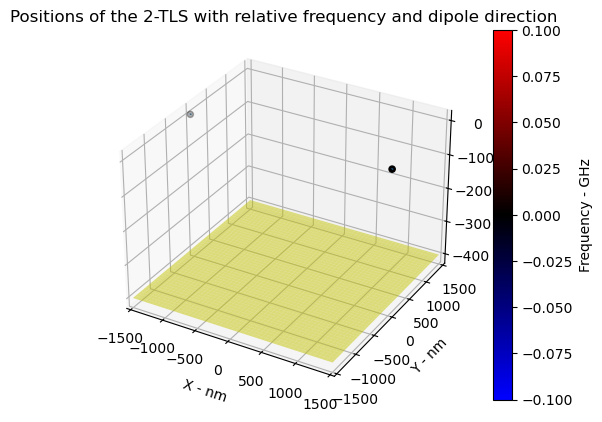

[0.14503648 0.15365387]


In [142]:
Nx = 2
Ny = 1
N_TLS = Nx*Ny
                                    #distance between TLS
l0 = 3000 # in nm
                                    # define the positions of all TLS
#R = ordered_chain(l0, N_TLS)
R, N_TLS = triang_triangular_lattice( l0, Nx, Ny )



lam0 = 785 # laser wavelength in nm
k0 = 2*np.pi/lam0       # for the dyadic one should in principle use k including the detuning. But 1Ghz of detuning is 10^-7 in k, completely irrelevant
                                    # total volume of the nanocrystal in nm
Lx = 100
Ly = 100
Lz = 100

sx, sy, sz, s_ = spin_operators(N_TLS)

                                    #reference electric field at lambda0 with d = 13 D
Edd_ref = 0.0248 # kV/cm
                                    #include a golden substrate
img_active = 1  #choose to use free space '==0' or half space '==1' dyadic Green function
z0 = - 400     #position in nm of the conductinc plate (only if img_active == 1)

                                    # in GHz - detuning of the molecules with respect external pump, molecules losses, dipole-dipole reference scale
gamma = .05  # homogeneous broadening, or Fourier limit linewidth
gamma_deph = 1. # pure dephasing rate (to be done properly I should include the detuning dependence that takes account of the phonons spectral density)
Udd = 1.    # coefficiente dimensionale dyadic in GHz -> Udd = e^2/epsilon0 k0^3 xi_d^2 ( e xi_d = dipole transition \approx 13 D )
Gamma0 = Udd/(3.*np.pi)     # ==== Single emitter diagonal spontaneous decay rate of the free space dyadic. Necessary to ensure stability.

OmR = 0.
sigma_freqs = 0.
                                    #arr_freq_dis = sigma_freqs*np.random.normal(0.0, 1., size=N_TLS) #array that stores fluctuations of TLS freqs., sigma is in GHz
arr_freq_dis = sigma_freqs*np.random.uniform(-1./2., 1./2., size=N_TLS)

                                    #detuning with respect external laser
det0 = 0. #* np.sqrt(N_TLS)        #in Ghz

Gam_p = 1.                           #Incoherent pump strength

                                    #select orientation dipoles
direction_dipole = 1    # x==0, y==1, z==2

                                    #define dipole moment axis of each TLS
D = partially_random_dipoles(N_TLS, direction_dipole, 0.0)

plot_points_with_vectors_substrate(R, D, 20., arr_freq_dis, z0)

Edrive = np.array([0, 0, 0])
Edrive[direction_dipole] = 1
projE = np.matmul( D, Edrive )
dir_k = np.array([0, 0, 1])
if direction_dipole == 2 or direction_dipole == 1:
    dir_k = np.array([1, 0, 0])

K = np.zeros(shape=(N_TLS, N_TLS), dtype=np.complex_)
K = interaction_matrix(R, D, k0, N_TLS, z0, img_active)

Gamma_tens = 2.*Udd*K.imag + (gamma + Gamma0)*np.eye( N_TLS )
ikvals, ikvecs = np.linalg.eig(Gamma_tens)
idx = np.argsort(ikvals)
ikvals = ikvals[idx]
ikvecs = ikvecs[:,idx]

dressed_jump = []
for nik in range(ikvals.size):
    for ntls in range(N_TLS):
        Gk = ikvals[nik]
        if Gk < 0:
            Gk = 0.
            print("diocanissimo")
        dressed_jump.append( np.sqrt( ( Gk + 1j*0.0 ) ) * ikvecs[ntls,nik] * s_[ntls] )
print(ikvals)

Heff = 0*sz[0] 
arr_cjump = []
Ltot = 0*lindblad_dissipator( s_[0] )
for n1 in range(N_TLS):
    Heff += ( det0 + arr_freq_dis[n1] ) * s_[n1].dag()*s_[n1] + .5*OmR * projE[n1] * (s_[n1]*np.exp(-1j*k0*np.dot(dir_k, R[n1]) ) + s_[n1].dag()*np.exp(+1j*k0*np.dot(dir_k, R[n1]) ) )
    arr_cjump.append( np.sqrt(Gam_p)*s_[n1].dag()  )
    arr_cjump.append( np.sqrt(gamma_deph)*s_[n1].dag()*s_[n1] )
    for n2 in range(N_TLS):
        Heff += - 1.*Udd*K[n1][n2].real * s_[n1].dag()*s_[n2]
arr_jump_tot = arr_cjump + dressed_jump
Ltot += liouvillian(Heff, arr_jump_tot)

rho_ss = steadystate(Ltot)



In [148]:
#Calcolating the electric field dyadic at a given distance, on the whole solid angle
# Set the fixed radius
dist = lam0*10
a_theta = np.linspace(0, 2.*np.pi, 60)
a_phi = np.linspace(0, np.pi/2., 60)    
polar_arr_Ex, polar_arr_Ey, polar_arr_Ez = polar_system_dyadic_field_amplitude( R, D, k0, N_TLS, a_theta, a_phi, dist, z0, img_active )


#Calcolating the electric field dyadic in (x,z)-space
a = 10
dist_ly = (np.amax(R[:,1]) + lam0*.5)
xvec_zx = np.linspace(-lam0*a, lam0*a, 100)
yvec_zx = np.array([ dist_ly ])
zvec_zx = np.linspace( 5*z0, lam0*a, 100)
arr_zx_Ex, arr_zx_Ey, arr_zx_Ez = system_dyadic_field_amplitude( R, D, k0, N_TLS, xvec_zx, yvec_zx, zvec_zx, z0, img_active )

#Calcolating the electric field dyadic in (x,y)-space
a = 10
xvec_xy = np.linspace(-lam0*a, lam0*a, 100)
yvec_xy = np.linspace(-lam0*a, lam0*a, 100)
zvec_xy = np.array([ np.amax(R[:,2]) + lam0*30 ])
arr_xy_Ex, arr_xy_Ey, arr_xy_Ez = system_dyadic_field_amplitude( R, D, k0, N_TLS, xvec_xy, yvec_xy, zvec_xy, z0, img_active )

In [149]:
Z_ss = np.zeros(shape=(N_TLS, N_TLS), dtype=np.complex_)
for n1 in range(N_TLS):
        for n2 in range(N_TLS):
            Z_ss[n1][n2] = expect( s_[n1].dag()*s_[n2], rho_ss )
print(Z_ss)

[[0.87006064+0.00000000e+00j 0.        -6.77626358e-20j]
 [0.        +6.77626358e-20j 0.87006064+0.00000000e+00j]]


In [150]:
proj_zx = np.zeros(shape=(zvec_zx.size, xvec_zx.size))
proj_xy = np.zeros(shape=(yvec_xy.size, xvec_xy.size))
proj_polar = np.zeros(shape=(a_theta.size, a_phi.size))


Eamp_solid = np.matmul(np.conj(polar_arr_Ex), np.matmul(Z_ss, polar_arr_Ex.T) ) + np.matmul(np.conj(polar_arr_Ey), np.matmul(Z_ss, polar_arr_Ey.T) ) + np.matmul(np.conj(polar_arr_Ez), np.matmul(Z_ss, polar_arr_Ez.T) )
Eamp_solid = np.diag(Eamp_solid)
Eamp_solid = Eamp_solid.reshape( (a_theta.size, a_phi.size) )
proj_polar += Eamp_solid.real

E_zx = np.matmul(np.conj(arr_zx_Ex), np.matmul(Z_ss, arr_zx_Ex.T) ) + np.matmul(np.conj(arr_zx_Ey), np.matmul(Z_ss, arr_zx_Ey.T) ) + np.matmul(np.conj(arr_zx_Ez), np.matmul(Z_ss, arr_zx_Ez.T) )
E_zx = np.diag(E_zx)
E_zx = E_zx.reshape( (zvec_zx.size, xvec_zx.size) ) 
proj_zx += E_zx.real

E_xy = np.matmul((arr_xy_Ex), np.matmul(Z_ss, np.conj(arr_xy_Ex.T)) ) + np.matmul((arr_xy_Ey), np.matmul(Z_ss, np.conj(arr_xy_Ey.T)) ) + np.matmul((arr_xy_Ez), np.matmul(Z_ss, np.conj(arr_xy_Ez.T)) )
E_xy = np.diag(E_xy)

#E_xy = np.abs(arr_xy_Ex[:,0])**2. * Z_ss[0][0] + np.abs(arr_xy_Ey[:,0])**2. * Z_ss[0][0] + np.abs(arr_xy_Ez[:,0])**2. * Z_ss[0][0]
#E_xy += np.abs(arr_xy_Ex[:,1])**2. * Z_ss[1][1] + np.abs(arr_xy_Ey[:,1])**2. * Z_ss[1][1] + np.abs(arr_xy_Ez[:,1])**2. * Z_ss[1][1]

E_xy = E_xy.reshape( (yvec_xy.size, xvec_xy.size) ) 
proj_xy += E_xy.real

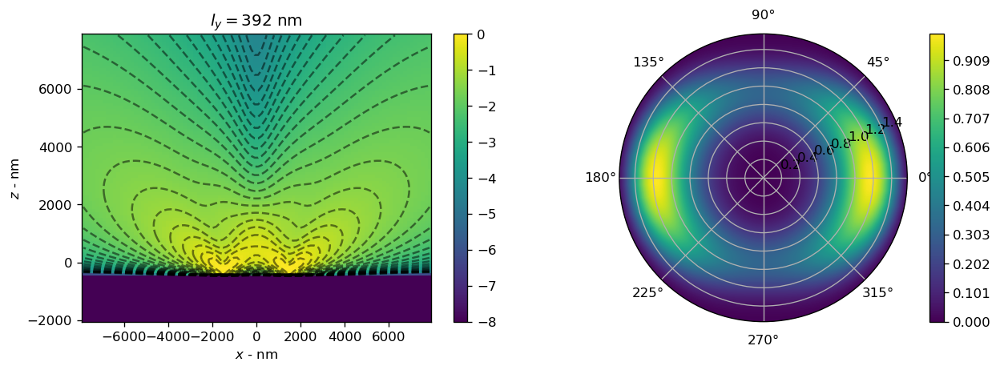

In [153]:
fig, ax = plt.subplots(1,2,dpi=120, figsize=(4, 2))

nz0 = np.argmin( np.abs(zvec_zx-z0) )
proj_zx[:,0:nz0] = 0
maxEmap_zx = np.amax(proj_zx)
X, Z = np.meshgrid(zvec_zx, xvec_zx)
vmin = -8
vmax = 0.
Emap_plot0 = ax[0].pcolormesh(Z, X, np.log(proj_zx/maxEmap_zx + .00000001)/np.log(10.), cmap='viridis', alpha=1, vmin=vmin, vmax=vmax)
contour_min = -5
contour_max = 0.
contour_interval = .2
levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
contours = ax[0].contour(Z, X, np.log(proj_zx/maxEmap_zx + .00000001)/np.log(10.), levels=levels, colors='black', alpha=.5)
ax[0].set_xlabel(r'$x$ - nm')
ax[0].set_ylabel(r'$z$ - nm')
ax[0].set_title(r'$l_y=%.0f$ nm' % (dist_ly))

"""
maxEmap_xy = np.amax(proj_xy)
print(maxEmap_xy)
X, Y = np.meshgrid(yvec_xy, xvec_xy)
vmin = .99
vmax = 1.
Emap_plot1 = ax[1].pcolormesh(Y, X, (proj_xy/maxEmap_xy), cmap='viridis', alpha=1, vmin=vmin, vmax=vmax)
contour_min = 0
contour_max = 1.
contour_interval = .1
levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
contours = ax[1].contour(Y, X, (proj_xy/maxEmap_xy), levels=levels, colors='black', alpha=.5)
ax[1].set_xlabel(r'$x$ - nm')
ax[1].set_ylabel(r'$y$ - nm')
"""
fig.delaxes(ax[1])  # remove the default axes at position 1
ax_polar = fig.add_subplot(1, 2, 2, projection='polar')  # add polar axes at that location

Theta, Phi = np.meshgrid(a_theta, a_phi)
max_polar=np.amax(proj_polar)
contour_min = .0
contour_max = 1.
contour_interval = .001
levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
vmin = .0
vmax = 1.
Emap_plot1 = ax_polar.contourf(Theta, Phi, proj_polar/max_polar, levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

# Set labels and title
#ax_polar.set_xlabel(r'$\theta$')
#ax_polar.set_ylabel(r'$\phi$')
#ax_polar.set_title('Polar Plot of intensity correlations')


fig.colorbar(Emap_plot0)
fig.colorbar(Emap_plot1)

plt.gcf().set_size_inches(270 / 25.4, 100 / 25.4)
plt.tight_layout()
#plt.savefig('dipole_emission_example.png',  dpi=300)
#plt.show()


In [105]:
dist = lam0*40.
theta = np.linspace( 0., 2.*np.pi, 120)
phi = np.linspace(0, np.pi/2., 120)
polar_Ex, polar_Ey, polar_Ez = polar_matrix_system_dyadic_field_amplitude( R, D, k0, N_TLS, theta, phi, dist, z0, img_active )

@njit
def polar_intensity_matrix(matE, Ni, Nj, Nn, M):
    for i in range(Ni):
        for j in range(Nj):
            for n in range(Nn):
                for m in range(Nn):
                    M[i][j][n][m] = np.conj(matE[i][j][n]) * matE[i][j][m]
    return M
# Get the shape of E
Ni, Nj, Nn = polar_Ex.shape
# Initialize the output tensor M_ijnm
Mxx = np.zeros((Ni, Nj, Nn, Nn), dtype=complex)
Myy = np.zeros((Ni, Nj, Nn, Nn), dtype=complex)
Mzz = np.zeros((Ni, Nj, Nn, Nn), dtype=complex)
Ixx = polar_intensity_matrix(polar_Ex, Ni, Nj, Nn, Mxx)
Iyy = polar_intensity_matrix(polar_Ey, Ni, Nj, Nn, Myy)
Izz = polar_intensity_matrix(polar_Ez, Ni, Nj, Nn, Mzz)

I = Ixx + Iyy + Izz

I[1:theta.size,0,:,:] = I[1:theta.size,0,:,:].copy()*0 #remove the Ntheta-copies of the north-pole
Mprovv = np.zeros((Ni, Nj, Nn, Nn), dtype=complex)

theta_NA = np.pi/16

I_avg = solid_angle_averaging(I, Mprovv, theta, phi, theta_NA)

In [106]:
print(np.sin(theta_NA))

0.19509032201612825


In [107]:
M_detect = I_avg[0,0,:,:]
m_vals, m_vecs = np.linalg.eig(M_detect)
idx = np.argsort(m_vals)
m_vals = m_vals[idx]
m_vecs = m_vecs[:,idx]

f_ = []
for k, ek in enumerate(m_vals):
    f_op = s_[0]*0
    for n in range(len(m_vals)):
        f_op += s_[n] * np.conj(m_vecs[n,k]) * np.sqrt( ek/np.amax(np.abs(m_vals)) )
    f_.append(f_op)
    
fsr_op = s_[0]*0
for n in range(N_TLS):
    fsr_op += s_[n]/np.sqrt(N_TLS)
fsub_op = (s_[0] - s_[1])/2**.5    
        
print(M_detect/np.amax(np.abs(M_detect)), m_vecs[:,0], m_vals/np.amax(np.abs(m_vals)) )


[[0.99990121+0.j         0.47410845-0.00727965j]
 [0.47410845+0.00727965j 1.        +0.j        ]] [ 0.70714361+0.j         -0.70698661-0.01085535j] [0.35667928-5.17464816e-19j 1.        +5.17464816e-19j]


In [108]:
taus = np.linspace(0., 6., 1000)
C2 = np.zeros(len(taus), dtype=np.complex_)
Csr = np.zeros(len(taus), dtype=np.complex_)
Csub = np.zeros(len(taus), dtype=np.complex_)
N1 = 0
Nsr = 0
Nsub = 0
Nsr = expect( fsr_op.dag()*fsr_op, rho_ss)
Nsub = expect( fsub_op.dag()*fsub_op, rho_ss)
for k1 in range(len(m_vals)):
    N1 += expect( f_[k1].dag()*f_[k1], rho_ss)
    print( expect( s_[k1].dag()*s_[k1], rho_ss), expect( f_[k1].dag()*f_[k1], rho_ss) )
    for k2 in range(len(m_vals)):
        C2 += correlation_3op_1t( Heff, rho_ss, taus, arr_jump_tot, f_[k1].dag(), f_[k2].dag()*f_[k2], f_[k1] )
        Csr += correlation_3op_1t( Heff, rho_ss, taus, arr_jump_tot, f_[k1].dag(), fsr_op.dag()*fsr_op, f_[k1] )
        Csub += correlation_3op_1t( Heff, rho_ss, taus, arr_jump_tot, f_[k1].dag(), fsub_op.dag()*fsub_op, f_[k1] )
g2 = C2 / N1**2
g2sr = Csr / (Nsr*N1)
g2sub = Csub / (Nsub*N1)

#C2 = correlation_3op_1t( Heff, rho_ss, taus, arr_jump_tot, s_[0].dag(), s_[0].dag()*s_[0], s_[0] )
#N1 = expect( s_[0].dag()*s_[0], rho_ss)
#g2 = C2#/N1**2


0.8515758917814015 0.30373948017511887
0.8515758917814014 0.8515758917814018


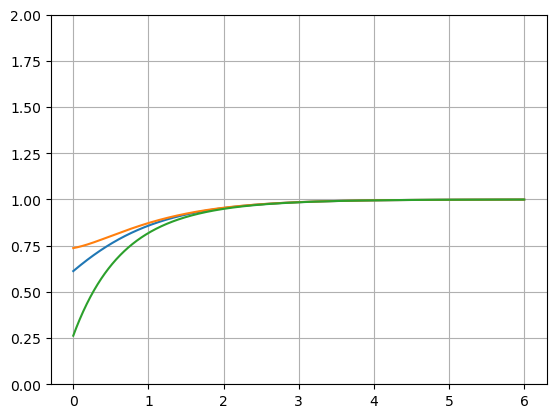

In [109]:
plt.plot(taus, g2.real)
plt.plot(taus, g2sr.real/2)
plt.plot(taus, g2sub.real/2)

plt.ylim(0,2)
plt.grid()

In [157]:
polar_E_expanded = np.zeros(shape=(polar_arr_Ex.shape[0],polar_arr_Ex.shape[1], polar_arr_Ex.shape[1]), dtype=np.complex_ )
polarE = [polar_arr_Ex, polar_arr_Ey, polar_arr_Ez]
for ii in range(3):
    A = polarE[ii].copy()
    B = np.conj(A.copy())
    A_expanded = A[:, :, np.newaxis]
    B_expanded = B[:, np.newaxis, :]
    polar_E_expanded += A_expanded * B_expanded

In [538]:
@njit
def extract_diagonal(matrix):
    n = min(matrix.shape[0], matrix.shape[1])
    diagonal = np.empty(n, dtype=matrix.dtype)
    for i in range(n):
        diagonal[i] = matrix[i, i]
    return diagonal
@njit
def corr_dome(a_theta, a_phi, polar_E_expanded, pi_polar_E_expanded, N_TLS, s_Corr, Ndet):
    arr_I2 = np.zeros(shape=(Ndet, a_theta.size, a_phi.size), dtype=np.complex_)
    Icorr_SpecInt = np.zeros( shape=(a_theta.size, a_phi.size), dtype=np.complex_ )
    for nc in range(Ndet):
        C4 = s_Corr[nc]
        II = np.zeros(shape=(polar_E_expanded.shape[0], pi_polar_E_expanded.shape[0]), dtype=np.complex_)
        for n1 in range(N_TLS):
            for n2 in range(N_TLS):
                for n3 in range(N_TLS):
                    for n4 in range(N_TLS):
                        II += C4[n1][n2][n3][n4] * polar_E_expanded[:,n1,n3] * polar_E_expanded[:, n2, n4]
        
        #I2_solid_diag = np.abs( np.diagonal( II ) )
        I2_solid_diag = extract_diagonal(II)
        
        I2_solid_diag = I2_solid_diag.reshape( (a_theta.size, a_phi.size) )
        Icorr_SpecInt += I2_solid_diag
        arr_I2[nc] = I2_solid_diag
        #arr_I2.append( I2_solid_diag )
    #arr_I2 = np.asarray(arr_I2)

    norm_arr_I2 = Icorr_SpecInt#/( np.sum(np.abs(arr_Esolid), axis=0 )*np.sum(np.abs(arr_Esolid_pi), axis=0 ) )
    return norm_arr_I2

norm_arr_I2 = corr_dome(a_theta, a_phi, polar_E_expanded, polar_E_expanded, N_TLS, s_Corr, Ndet)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/matplotlib/contour.py:1568: ComplexWarning:

Casting complex values to real discards the imaginary part

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/matplotlib/contour.py:1569: ComplexWarning:

Casting complex values to real discards the imaginary part

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/numpy/ma/core.py:2820: ComplexWarning:

Casting complex values to real discards the imaginary part



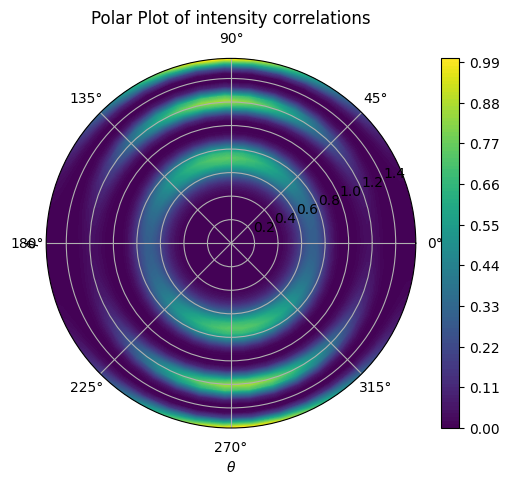

In [539]:
Theta, Phi = np.meshgrid(a_theta, a_phi)
# Create a polar plot
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
# Plot the function values as a color map
max_logEsolid =  np.amax(norm_arr_I2)
#contour_min = -1
#contour_max = 0
#contour_interval = .05
#levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
#vmin = -1
#vmax = 0
#c = ax.contourf(Theta, Phi, np.log(arr_Esolid[0]/max_logEsolid + 10.**(contour_min+2*contour_interval) ), levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

contour_min = .0
contour_max = 1.
contour_interval = .01
levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
vmin = .0
vmax = 1.
c = ax.contourf(Theta, Phi, norm_arr_I2/max_logEsolid, levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

# Add a color bar
fig.colorbar(c)
# Set labels and title
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\phi$')
ax.set_title('Polar Plot of intensity correlations')

# Show the plot
plt.show()

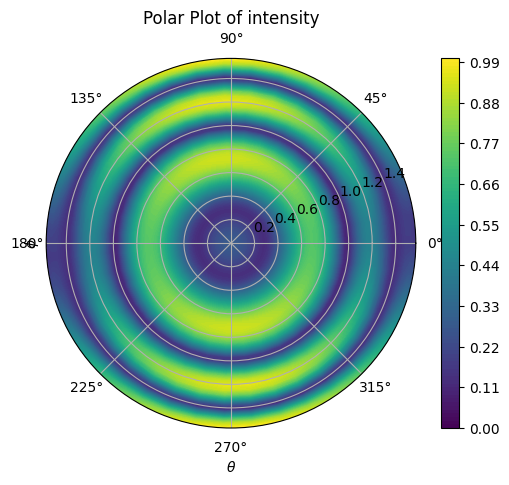

In [540]:
sum_Esolid = np.sum(arr_Esolid, axis=0)
Theta, Phi = np.meshgrid(a_theta, a_phi)
# Create a polar plot
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
# Plot the function values as a color map
max_logEsolid =  np.amax(sum_Esolid)
#contour_min = -1
#contour_max = 0
#contour_interval = .05
#levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
#vmin = -1
#vmax = 0
#c = ax.contourf(Theta, Phi, np.log(arr_Esolid[0]/max_logEsolid + 10.**(contour_min+2*contour_interval) ), levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

contour_min = .0
contour_max = 1.
contour_interval = .01
levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
vmin = .0
vmax = 1.
c = ax.contourf(Theta, Phi, sum_Esolid/max_logEsolid, levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

# Add a color bar
fig.colorbar(c)
# Set labels and title
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\phi$')
ax.set_title('Polar Plot of intensity')

# Show the plot
plt.show()

In [100]:
#Video of the electric field amplitude on the solid angle as a function of the control parameter

from matplotlib.animation import FuncAnimation
from IPython.display import HTML


Theta, Phi = np.meshgrid(a_theta, a_phi)
# Create a polar plot
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
# Plot the function values as a color map
max_logEsolid =  np.amax(arr_I2)
#contour_min = -1
#contour_max = 0
#contour_interval = .05
#levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
#vmin = -1
#vmax = 0
#c = ax.contourf(Theta, Phi, np.log(arr_Esolid[0]/max_logEsolid + 10.**(contour_min+2*contour_interval) ), levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

contour_min = .0
contour_max = 1.
contour_interval = .05
levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
vmin = .5
vmax = 1.
c = ax.contourf(Theta, Phi, arr_I2[0]/max_logEsolid, levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

# Add a color bar
fig.colorbar(c)
# Set labels and title
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\phi$')
ax.set_title('Polar Plot of $f(x, y, z)$')
plt.close(fig)  # Prevent static figure from displaying

# Show the plot
#plt.show()

def update_Esolid(frame):    
    # Clear the previous contour plots
    ax.clear()
    
    # Re-plot the updated contour plots
    #c = ax.contourf(Theta, Phi, np.log(arr_Esolid[frame]/max_logEsolid + 10.**(contour_min+2*contour_interval)), levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)
    c = ax.contourf(Theta, Phi, arr_I2[frame]/max_logEsolid, levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)
    
    # Update title for current frame
    ax.set_title('Half-dome Polar Plot of far field')
    
    return c.collections

# Create animation
fps = 10
ani_Esolid = FuncAnimation(fig, update_Esolid, frames=len(arr_Esolid), blit=False, interval=1000/fps)

# Display animation
HTML(ani_Esolid.to_jshtml())


/var/folders/y4/dpq6l9fj2kv9z0prq_6_pyy00000gn/T/ipykernel_25063/3996209601.py:50: MatplotlibDeprecationWarning:

The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.



In [92]:
#Video of the electric field amplitude in the space (x,z) as a function of the control parameter

from matplotlib.animation import FuncAnimation
from IPython.display import HTML

maxEmap = np.amax(arr_Eamp)
# Initialize figure for Efield function animation
fig_E, ax_E = plt.subplots(dpi=120, figsize=(4, 4))
X, Y = np.meshgrid(xvec, yvec)

#vmin = -4
#vmax = 1
#Emap_plot = ax_E.pcolormesh(Y, X, np.log(arr_Eamp[0]/maxEmap)/np.log(10.), cmap='viridis', alpha=1, vmin=vmin, vmax=vmax)

vmin = 0.5
vmax = 1.2
Emap_plot = ax_E.pcolormesh(Y, X, arr_Eamp[0]/maxEmap, cmap='viridis', alpha=1, vmin=vmin, vmax=vmax)

contour_min = .5
contour_max = 1.
contour_interval = .1
levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)

#contours = ax_E.contour(Z, X, arr_Eamp[0], levels=levels, colors='black', alpha=.5)
#contour_labels = ax_E.clabel(contours, inline=True, fontsize=8, fmt='%.1f')

fig_E.colorbar(Emap_plot)

ax_E.set_xlabel(r'$x$ - nm')
ax_E.set_ylabel(r'$y$ - nm')
ax_E.set_aspect('equal')
plt.close(fig_E)  # Prevent static figure from displaying


# Store the contour collections for removal
contour_collections = []
def update_Eamp(frame):
    global contour_collections
    
    #Eupd = np.log(arr_Eamp[frame]/maxEmap)/np.log(10.)
    Eupd = arr_Eamp[frame]/maxEmap
    Emap_plot.set_array( Eupd.reshape(xvec.size*yvec.size ) )

    # Remove old contour plots
    while contour_collections:
        c = contour_collections.pop()
        c.remove()

    # Create new contour plot
    contours = ax_E.contour(Y, X, arr_Eamp[frame]/maxEmap, levels=levels, colors='black', alpha=.5)
    #contour_labels = ax_E.clabel(contours, inline=True, fontsize=8, fmt='%.1f')
    
    # Store new contour collections for the next update
    contour_collections.extend(contours.collections)

    return [Emap_plot] + contours.collections

# Create animation
fps = 10
ani_E = FuncAnimation(fig_E, update_Eamp, frames=len(arr_Eamp), blit=True, interval=1000/fps)

# Display animation
HTML(ani_E.to_jshtml())

/var/folders/y4/dpq6l9fj2kv9z0prq_6_pyy00000gn/T/ipykernel_87629/308196491.py:54: MatplotlibDeprecationWarning:

The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.

/var/folders/y4/dpq6l9fj2kv9z0prq_6_pyy00000gn/T/ipykernel_87629/308196491.py:56: MatplotlibDeprecationWarning:

The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.

/var/folders/y4/dpq6l9fj2kv9z0prq_6_pyy00000gn/T/ipykernel_87629/308196491.py:54: MatplotlibDeprecationWarning:

The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.

/var/folders/y4/dpq6l9fj2kv9z0prq_6_pyy00000gn/T/ipykernel_87629/308196491.py:56: MatplotlibDeprecationWarning:

The collections attribute was deprecated in Matplotlib 3.8 and will be removed two minor releases later.



In [ ]:
ani_E.save('2Dip_2Dspace_emission_vs_Dip_position.gif', writer='pillow', fps=30)

ani_Esolid.save('2Dip_half_dome_emission_vs_Dip_position.gif', writer='ffmpeg', fps=30)

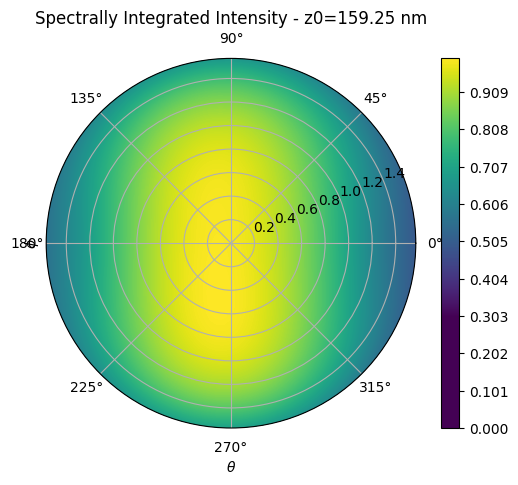

In [205]:

Theta, Phi = np.meshgrid(a_theta, a_phi)
# Create a polar plot
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'})
# Plot the function values as a color map
sum_Esolid = np.sum(arr_Esolid, axis=0)
max_sumEsolid =  np.amax(sum_Esolid)
#contour_min = -1
#contour_max = 0
#contour_interval = .05
#levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
#vmin = -1
#vmax = 0
#c = ax.contourf(Theta, Phi, np.log(arr_Esolid[0]/max_logEsolid + 10.**(contour_min+2*contour_interval) ), levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

contour_min = .0
contour_max = 1.
contour_interval = .001
levels = np.arange(contour_min, contour_max + contour_interval, contour_interval)
vmin = .3
vmax = 1.
c = ax.contourf(Theta, Phi, sum_Esolid/(max_sumEsolid), levels=levels, cmap='viridis', vmin=vmin, vmax=vmax)

# Add a color bar
fig.colorbar(c)
# Set labels and title
ax.set_xlabel(r'$\theta$')
ax.set_ylabel(r'$\phi$')
ax.set_title('Spectrally Integrated Intensity - z0=%.2f nm' % (np.abs(z0)))
plt.show()

#plt.savefig('polar_int_int_z0=%.2fnm.pdf' % (np.abs(z0)) )  
